In [1]:
from IPython.display import HTML
HTML('''<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
The raw code for this IPython notebook is by default hidden for easier reading.
To toggle on/off the raw code, click <a href="javascript:code_toggle()">here</a>.''')

# M2.1 - Exploratory Data Visualization Charts and Summary Statistics
**Sergio Figueroa - Ironhack Data PT Madrid - 2020**

💎 Exploratory data analysis report about diamonds. Find and download the dataset [here](http://www.potacho.com/files/ironhack/diamonds_train.csv). 💎

## 0. The Index Enumeration

🔷 The Diamonds Basics 

🔷 The Analytic Requirements 

🔷 The Dataset Description

🔷 The Main Statistics

🔷 The Lineal Correlations

🔷 The Valuable Calculations

🔷 The BI Visualizations

## 1. The Diamonds Basics

Diamonds value are stablished by specific qualities. The gemological NPA GIA created a globally accepted standard for describing diamonds: **Color, Clarity, Cut and Carat Weight**. This analysis will cover visually those known as the **Diamonds 4Cs** and other measurements afecting the price of a diamond. Following, you'll find GIA's definitions:

🔹 Color: GIA's D-to-Z color-grading system measures the degree of colorlessness by comparing a stone under controlled lighting and precise viewing conditions to masterstones of established color value. The scale begins with the letter D, representing colorless, and continues, with increasing presence of color, to the letter Z.

🔹 Clarity: Evaluating diamond clarity involves determining the number, size, relief, nature, and position of 'inclusions' and 'blemishes.', as well as how these affect the overall appearance of the stone. The GIA Clarity Scale has 6 categories, some of which are divided for a total of 11 specific grades.

🔹 Cut: A diamond's cut grade is really about how well a diamond's facets interact with light. The GIA Cut Grading System for the standard round brilliant diamond evaluates seven components. 

🔹Carat: Diamond carat weight is the measurement of how much a diamond weighs. A metric "carat" is defined as 200 milligrams. Each carat can be subdivided into 100 'points.' This allows very precise measurements to the hundredth decimal place.

## 2. The Analytic Requirements

Documentation:

* [GIA](https://4cs.gia.edu/en-us/)
* [Lumera Diamonds](https://www.lumeradiamonds.com/diamond-education/index)
* [Brilliance](https://www.brilliance.com/education/diamonds/depth-table)
* [DnDLondon](https://www.dndlondon.com/pages/diamond-carat-weight-vs-measurements)

Import:

* import pandas as pd
* import matplotlib.pyplot as plt
* import seaborn as sns
* from IPython.display import set_matplotlib_formats
* import cufflinks as cf

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import set_matplotlib_formats
import cufflinks as cf

In [2]:
cf.go_offline()

## 3. The Dataset Description
First, let's take a look at Diamonds dataset...

In [3]:
diamonds = pd.read_csv('../data/raw/diamonds_train.csv')
dsample = diamonds.sample(2000, random_state=500)

In [4]:
diamonds.head(5)

,carat,cut,color,clarity,depth,table,price,x,y,z
0,1.21,Premium,J,VS2,62.4,58.0,4268,6.83,6.79,4.25
1,0.32,Very Good,H,VS2,63.0,57.0,505,4.35,4.38,2.75
2,0.71,Fair,G,VS1,65.5,55.0,2686,5.62,5.53,3.65
3,0.41,Good,D,SI1,63.8,56.0,738,4.68,4.72,3.00
4,1.02,Ideal,G,SI1,60.5,59.0,4882,6.55,6.51,3.95


🔹 Diamonds dataset contains 40455 entries referring to a single diamond each one. Apparently, there is no null data in it, meaning that every entry is symmetrically comparable to any other one. Every diamong present a set of 10 cuantitative and qualitative atributes, represented by different column types:
- Categorical --> object type
- Numerical --> float64 or int64 types.

🔹 Diamonds 4Cs are presented along five important measurements that help us to understand the shape of the
diamond: depth percentage, table percentage and size, being x and y face-up diameter and z the height of the piece. 

🔹Depht Percentage has been calculated as height by the mean of both diameter measures. Or "z / mean(x+y)".

In [7]:
diamonds.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40455 entries, 0 to 40454
Data columns (total 10 columns):
carat      40455 non-null float64
cut        40455 non-null object
color      40455 non-null object
clarity    40455 non-null object
depth      40455 non-null float64
table      40455 non-null float64
price      40455 non-null int64
x          40455 non-null float64
y          40455 non-null float64
z          40455 non-null float64
dtypes: float64(6), int64(1), object(3)
memory usage: 3.1+ MB


## 4.1 The Main Statistics - Numerical
This is the distribution of numerical variables.

In [8]:
'''Carat as ct. 1ct = 0.g gr.
As carat size increases, diamond's price increases at increasing rate Bc larger the diamond, more increasingly rare
< 1/1000000 rough stones are large enough to produce a finished 1 carat diamond. 
So, as carat weight increases, you will typically pay more not only in total, but on a price-per-carat (PPC) basis.
PPC: total price/carat weight. measure when comparing diamonds of similar but not identical carat weights.
Carat size: when carat weightx3 (1 to 3 ct), perceived size roughly x3 | diameter x1.45 (6.50 to 9.40) | crown area slightly more x2

Depth: from table to culet depth % of a diamond is calculated by dividing the depth by the width of the diamond
The lower the depth %, the larger a diamond of a given carat weight will appear

Table: Table percentage = table width / overall width.
ideal table percentage will vary based on the shape. For round-cut diamonds is between 54-60 percent, 
'''

diamonds.describe()

,carat,depth,table,price,x,y,z
count,40455.000000,40455.000000,40455.000000,40455.000000,40455.000000,40455.000000,40455.000000
mean,0.797706,61.752841,57.446133,3928.444469,5.729392,5.732819,3.537154
std,0.475544,1.431725,2.233535,3992.416147,1.124453,1.146650,0.697062
min,0.200000,43.000000,43.000000,326.000000,0.000000,0.000000,0.000000
25%,0.400000,61.000000,56.000000,945.000000,4.710000,4.720000,2.910000
50%,0.700000,61.800000,57.000000,2397.000000,5.690000,5.710000,3.520000
75%,1.040000,62.500000,59.000000,5331.000000,6.540000,6.540000,4.035000
max,4.500000,79.000000,95.000000,18823.000000,10.230000,58.900000,8.060000


🔹 As we can see in the standard deviation parameter, there is a very big range of carat and price values. Maximum carat (weigth) is 22.5 times bigger than minimun carat, while the gap is 60 times in price. In the opposite side are %depth and %table, with every value close to the mean.

🔹 Minimun measures equal to zero reveal a few hidden null values. There are in total 16 entries where one or more of these parameteres is missing. Let's take a look at these entries.

In [9]:
diamonds[(diamonds['x'] == 0) | (diamonds['y'] == 0) | (diamonds['z']== 0)]

,carat,cut,color,clarity,depth,table,price,x,y,z
1606,1.01,Premium,F,SI2,59.2,58.0,3837,6.50,6.47,0.0
3945,2.02,Premium,H,VS2,62.7,53.0,18207,8.02,7.95,0.0
6465,0.71,Good,F,SI2,64.1,60.0,2130,0.00,0.00,0.0
13839,2.80,Good,G,SI2,63.8,58.0,18788,8.90,8.85,0.0
14815,1.07,Ideal,F,SI2,61.6,56.0,4954,0.00,6.62,0.0
14891,2.18,Premium,H,SI2,59.4,61.0,12631,8.49,8.45,0.0
16425,2.20,Premium,H,SI1,61.2,59.0,17265,8.42,8.37,0.0
19856,1.00,Premium,G,SI2,59.1,59.0,3142,6.55,6.48,0.0
21602,1.15,Ideal,G,VS2,59.2,56.0,5564,6.88,6.83,0.0
24795,1.10,Premium,G,SI2,63.0,59.0,3696,6.50,6.47,0.0


🔹 Are outliers a problem for the analysis? A lot of values fall out of the whiskers in the price column, due to the huge rance of prices. That wide spectrum also makes the IQ range quite big, meaning that there are a lot of different prices to understand.

In [10]:
diamonds[['price', 'carat']].iplot(kind='box', boxpoints='outliers', colorscale='Greens', subplots=True)

In [11]:
diamonds[['depth', 'table']].iplot(kind='box', boxpoints='outliers', subplots=True)

## 4.2 The Main Statistics - Categorical
Let's study the categorical 3Cs...

🔹 To some experts, cut is the most important C determining a diamond cost. There are five categories in the dataset and most of the values lie in the top three bins. As explained by Lumera Diamonds:

> "A too-deep cut diamond would yield a significantly larger diamond, earning the diamond cutter a larger profit on his investment. A smaller, well cut diamond may sell for less in total than the larger diamond, but it will command a higher price-per-carat not only because of its superior appearance, but also due to decreased yield from the rough stone (which therefore makes the diamond more expensive to create)"


In [12]:
sorter = ['Ideal', 'Premium', 'Very Good', 'Good', 'Fair']
diamonds['cut'] = diamonds['cut'].astype("category")
diamonds['cut'].cat.set_categories(sorter).sort_values().iplot(kind='hist', 
                                                               title='Diamonds per Cut', 
                                                               color='lightblue', 
                                                               yTitle='Number of Diamonds', 
                                                               xTitle='Cut types')

🔹 Out of five color bins from GIA's standars, diamond in the dataset are included in types Colorless (D,E,F) or Near Colorless (G,H,I,J). The distribution is variable, with a tail tending to the lowest quality.

In [13]:
diamonds['color'].sort_values().iplot(kind='hist', 
                                      color='lightblue', 
                                      title='Diamonds per Color', 
                                      yTitle='Number of Diamonds', 
                                      xTitle='Color Grades')

🔹 Clarity reveals the imperfections inside (inclusions) or on the surface (blemishes) of a diamong. Quality order is as follows: FL > IF > 'VVS1', 'VVS2' > 'VS1', 'VS2' > 'SI1', 'SI2' > I1 - I3. There are not flawless diamonds here and just a few internally flawless and the mayority lie on the second half of the spectrum.

In [14]:
sorter = ['IF', 'VVS1', 'VVS2', 'VS1', 'VS2', 'SI1', 'SI2','I1']
diamonds['clarity'] = diamonds['clarity'].astype('category')
diamonds['clarity'].cat.set_categories(sorter).sort_values().iplot(kind='hist', 
                                                                   color='lightblue', 
                                                                   title='Diamonds per Color', 
                                                                   yTitle='Number of Diamonds', 
                                                                   xTitle='Clarity Grades')

## 4.2 The Main Statistics - Summary
Combining both studies and a few more operations, we got to know the dataset a little bit better.

In [17]:
diamonds.mode()

,carat,cut,color,clarity,depth,table,price,x,y,z
0,0.3,Ideal,G,SI1,61.9,56.0,605,4.37,4.37,2.69


🔹 There are non identical diamonds in the whole sample. Every single one is unique, but we could define the "most common" diamond by combining column modes.

🔹 The **most common** would look like this:
- carat: 0.3
- cut: Ideal
- color: G
- clarity: SI1
- depth: 61.9
- table: 56.0
- price: 605
- x, y and z: 4.37 / 4.37 / 2.69

🔹 The **cheapest** diamond is like this:
- carat: 0.21
- cut: Premium
- color: E
- clarity: SI1
- depth: 59.8
- table: 61.0
- price: 326
- x, y and z: 3.89 / 3.84 / 2.31

🔹 The **most expensive** diamond is this one:
- carat: 2.29
- cut: Premium
- color: I
- clarity: VS2
- depth: 60.8
- table: 60.0
- price: 18823
- x, y and z: 8.50 / 8.47 / 5.16
										

In [26]:
diamonds.sort_values('price')

In [38]:
duplicates = diamonds[diamonds.duplicated()]

In [40]:
duplicates.sort_values('price')

## 5. The Lineal Correlations
It's time to find relationships between variables. Let's start with a correlation matrix...

In [41]:
sns.set_style("whitegrid")

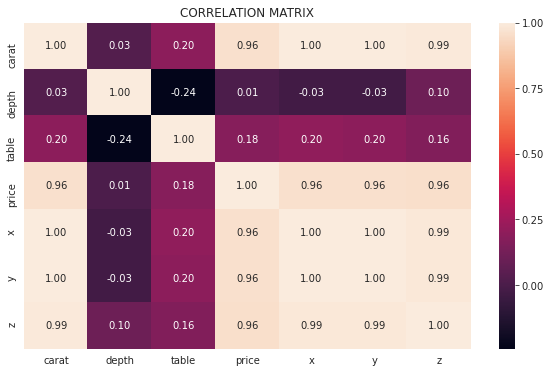

In [42]:
fig = plt.figure(figsize=(10,6))
ax = sns.heatmap(diamonds.corr(method='spearman'), annot=True, fmt=".2f")
ax.set_title('CORRELATION MATRIX')
plt.show();

🔹 The correlation matrix show a strong positive correlation between price, carat and dimensions. We will calculate and add a new column with the standard value price-per-carat (PPC) for further operations. However, the correlation between carat and price is not totally lineal. Price per carat rises strongly until around 2.5 carat and stumbles on outliers with sharp ups and downs.



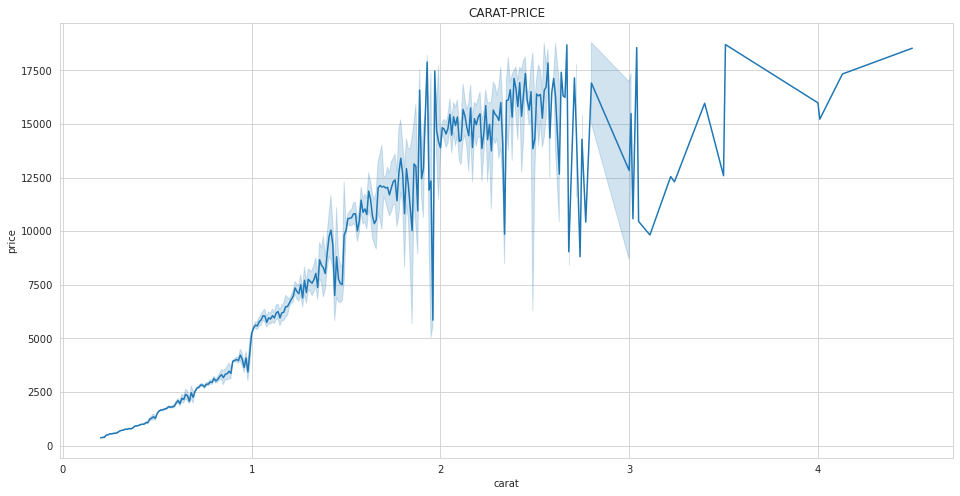

In [43]:
fig, ax = plt.subplots(ncols=1, nrows=1, figsize=(16, 8))

ax.set_title('CARAT-PRICE')
ax1 = sns.lineplot(data=diamonds, x='carat', y='price')
ax.xaxis.set_tick_params()
plt.show();

🔹 As we knew from the matrix view, there is not a lineal correlation between cut, color or clarity and price. Furthermore, there is an unexpected insight: the most expensive diamonds are the colored ones. There might be another reason...

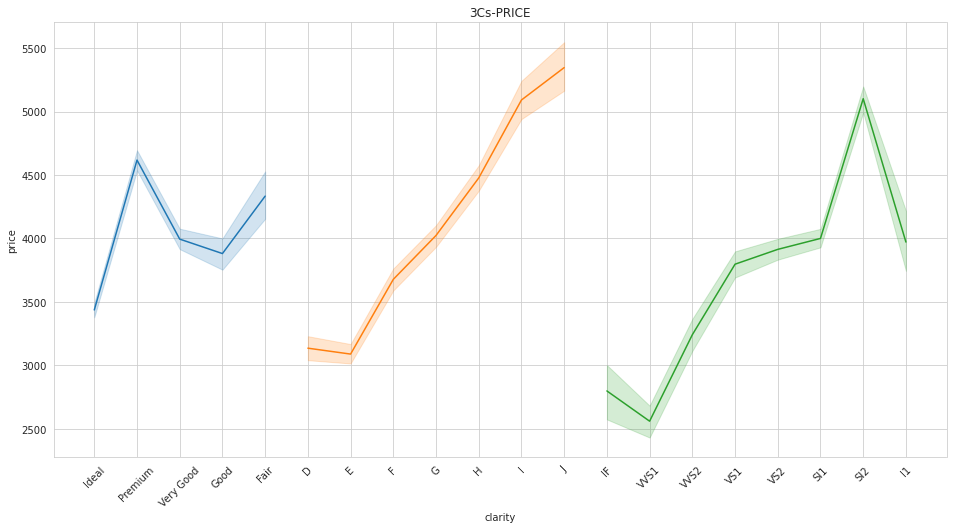

In [44]:
sortercut = ['Ideal', 'Premium', 'Very Good', 'Good', 'Fair']
diamonds['cut'] = diamonds['cut'].astype("category")
diamonds['cut'] = diamonds['cut'].cat.set_categories(sortercut).sort_values()

sortercla = ['IF', 'VVS1', 'VVS2', 'VS1', 'VS2', 'SI1', 'SI2','I1']
diamonds['clarity'] = diamonds['clarity'].astype('category')
diamonds['clarity'] = diamonds['clarity'].cat.set_categories(sortercla).sort_values()

fig, ax = plt.subplots(ncols=1, nrows=1, figsize=(16, 8))

ax.set_title('3Cs-PRICE')
ax2 = sns.lineplot(data=diamonds, x='cut', y='price')
ax3 = sns.lineplot(data=diamonds, x='color', y='price')
ax4 = sns.lineplot(data=diamonds, x='clarity', y='price')
ax.xaxis.set_tick_params(rotation=45)
plt.show();

🔹 Is table a huge factor affecting the price? Doesn't seem so according to the final chart of this section. You could find any price in any range of table percentage.

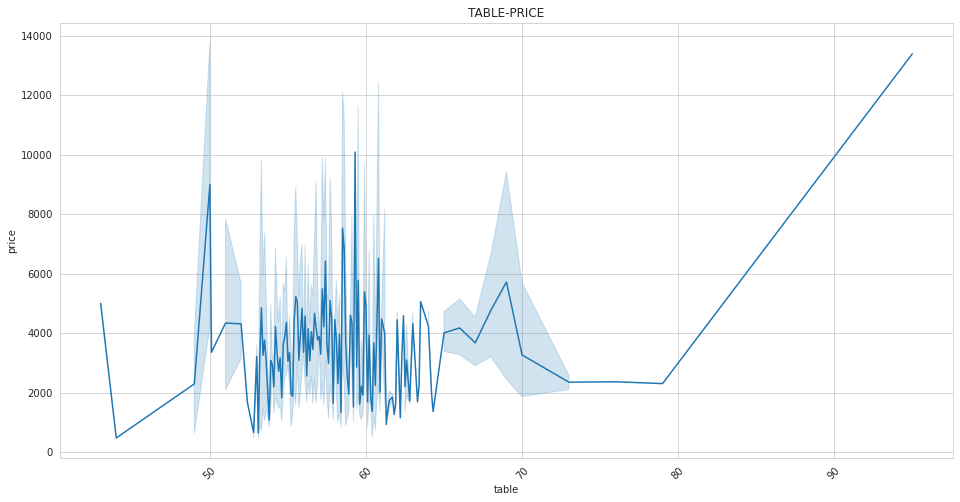

In [45]:
fig, ax = plt.subplots(ncols=1, nrows=1, figsize=(16, 8))

ax.set_title('TABLE-PRICE')
ax = sns.lineplot(data=diamonds, x='table', y='price')
ax.xaxis.set_tick_params(rotation=45)
plt.show();

## 6. The Valuable Calculations
Now that we know *our diamonds*, it's time to study variations and behaviour of prices. Well do some calculations here, but results will be available at the linked BI visualization.

🔹 In first place, let's create a new column for price-per-carat as PPC. This new value is optimal to take out the impact of carat (weight) in the total cost of a diamond. We can do that since there is a lineal and almost one to one relation between both parameters for the most part of the distribution. 

In [5]:
diamonds['PPC'] = diamonds['price']/diamonds['carat']

In [6]:
diamonds_ppc = diamonds

In [48]:
#concat_diamonds.to_csv('../data/raw/diamonds_ppc.csv')

We effectively can see that,as per price, one would think that diamonds corresponding to the less valuable color are more expensive. But the PPC measure balance part of the the bias. We will explore deeply this relationship in the BI visualizations.

In [49]:
diamonds_ppc[['color', 'PPC']].pivot(columns='color', values='PPC').iplot(kind='box',
                                                                title='Color per PPC', 
                                                                yTitle='Price of Diamonds per carat', 
                                                                xTitle='Color types')
diamonds_ppc[['color', 'price']].pivot(columns='color', values='price').iplot(kind='box', 
                                                                title='Color per price', 
                                                                yTitle='Price of Diamonds per unit', 
                                                                xTitle='Color types')

In [60]:
diamonds_ppc[['cut', 'PPC']].pivot(columns='cut', values='PPC').iplot(kind='box', 
                                                                title='Cut per PPC', 
                                                                yTitle='Price of Diamonds per Carat', 
                                                                xTitle='Cut types')
diamonds_ppc[['cut', 'price']].pivot(columns='cut', values='price').iplot(kind='box', 
                                                                title='Cut per price', 
                                                                yTitle='Price of Diamonds per unit', 
                                                                xTitle='Cut types')

In [61]:
diamonds_ppc[['clarity', 'PPC']].pivot(columns='clarity', values='PPC').iplot(kind='box', 
                                                                title='Clarity per PPC', 
                                                                yTitle='Price of Diamonds per Carat', 
                                                                xTitle='Clarity types')
diamonds_ppc[['clarity', 'price']].pivot(columns='clarity', values='price').iplot(kind='box', 
                                                                title='Clarity per price', 
                                                                yTitle='Price of Diamonds per unit', 
                                                                xTitle='Clarity types')

In [ ]:
#To create a multiple bar plot for lots of categories...

cut = diamonds.pivot_table(values='price', 
                           columns='cut',
                           index='carat', 
                           aggfunc='mean')


color = diamonds.pivot_table(values='price', 
                           columns='color',
                           index='carat', 
                           aggfunc='mean')


clarity = diamonds.pivot_table(values='price', 
                           columns='clarity',
                           index='carat', 
                           aggfunc='mean')

concat_diamonds = pd.concat([cut, color, clarity], axis=1)
concat_diamonds.columns = ['Ideal', 'Premium', 'Very Good', 'Good', 'Fair', 
                           'D', 'E', 'F', 'G', 'H', 'I', 'J', 
                           'IF', 'VVS1', 'VVS2', 'VS1', 'VS2', 'SI1', 'SI2','I1']
concat_diamonds.reset_index(inplace=True)
concat_diamonds.fillna(0, inplace=True)
concat_diamonds


In [35]:
color_cut = diamonds_ppc.pivot_table(values='PPC',
                                    columns='cut',
                                    index='color',
                                    aggfunc='mean').round(2)
color_cut

cut,Fair,Good,Ideal,Premium,Very Good
color,,,,,
D,4255.64,3818.32,3783.58,4121.75,4061.55
E,3775.72,3806.76,3697.21,4001.45,3813.08
F,3764.11,3801.24,4044.77,4341.29,4139.87
G,3787.82,4045.14,4175.51,4320.45,4072.79
H,3799.71,3788.10,3846.46,4299.20,4023.54
I,3430.13,3839.92,3780.62,4285.08,4112.17
J,3334.73,3531.29,3693.94,4167.35,3824.97


In [36]:
def resta(x,y):
    return x-y


color_cut['dif'] = color_cut.apply(lambda x: resta(x['Ideal'], x['Fair']), axis=1 )    

In [37]:
color_cut

cut,Fair,Good,Ideal,Premium,Very Good,dif
color,,,,,,
D,4255.64,3818.32,3783.58,4121.75,4061.55,-472.06
E,3775.72,3806.76,3697.21,4001.45,3813.08,-78.51
F,3764.11,3801.24,4044.77,4341.29,4139.87,280.66
G,3787.82,4045.14,4175.51,4320.45,4072.79,387.69
H,3799.71,3788.10,3846.46,4299.20,4023.54,46.75
I,3430.13,3839.92,3780.62,4285.08,4112.17,350.49
J,3334.73,3531.29,3693.94,4167.35,3824.97,359.21


In [38]:
traspu = color_cut.T

In [39]:
traspu['dife'] = traspu.apply(lambda x: resta(x['D'], x['J']), axis=1)
traspu

color,D,E,F,G,H,I,J,dife
cut,,,,,,,,
Fair,4255.64,3775.72,3764.11,3787.82,3799.71,3430.13,3334.73,920.91
Good,3818.32,3806.76,3801.24,4045.14,3788.10,3839.92,3531.29,287.03
Ideal,3783.58,3697.21,4044.77,4175.51,3846.46,3780.62,3693.94,89.64
Premium,4121.75,4001.45,4341.29,4320.45,4299.20,4285.08,4167.35,-45.60
Very Good,4061.55,3813.08,4139.87,4072.79,4023.54,4112.17,3824.97,236.58
dif,-472.06,-78.51,280.66,387.69,46.75,350.49,359.21,-831.27


In [40]:
color_clarity = diamonds_ppc.pivot_table(values='PPC',
                                    columns='clarity',
                                    index='color',
                                    aggfunc='mean').round(2)
color_clarity

clarity,I1,IF,SI1,SI2,VS1,VS2,VVS1,VVS2
color,,,,,,,,
D,2946.95,9638.04,3638.66,3732.57,4219.21,3752.82,4963.99,4604.21
E,2871.51,5296.26,3632.59,3850.17,3905.04,3756.80,3930.52,3949.59
F,2733.94,4266.18,3859.45,3935.52,4337.61,4164.12,4268.23,4502.27
G,2662.55,3968.15,3741.90,4016.60,4429.51,4402.93,4021.86,4510.56
H,2950.59,3541.99,4197.87,4314.49,3894.86,4234.83,3186.37,3403.79
I,2730.29,3011.46,4060.61,4430.50,3926.36,4311.40,3018.84,3256.98
J,2778.54,3327.51,3818.78,4100.08,3704.54,3822.74,3778.07,4044.11


In [41]:
color_clarity['dif'] = color_clarity.apply(lambda x: resta(x['IF'], x['I1']), axis=1)    
color_clarity

clarity,I1,IF,SI1,SI2,VS1,VS2,VVS1,VVS2,dif
color,,,,,,,,,
D,2946.95,9638.04,3638.66,3732.57,4219.21,3752.82,4963.99,4604.21,6691.09
E,2871.51,5296.26,3632.59,3850.17,3905.04,3756.80,3930.52,3949.59,2424.75
F,2733.94,4266.18,3859.45,3935.52,4337.61,4164.12,4268.23,4502.27,1532.24
G,2662.55,3968.15,3741.90,4016.60,4429.51,4402.93,4021.86,4510.56,1305.60
H,2950.59,3541.99,4197.87,4314.49,3894.86,4234.83,3186.37,3403.79,591.40
I,2730.29,3011.46,4060.61,4430.50,3926.36,4311.40,3018.84,3256.98,281.17
J,2778.54,3327.51,3818.78,4100.08,3704.54,3822.74,3778.07,4044.11,548.97


In [42]:
traspo = color_clarity.T

In [43]:
traspo['dife'] = traspo.apply(lambda x: resta(x['D'], x['J']), axis=1)
traspo

color,D,E,F,G,H,I,J,dife
clarity,,,,,,,,
I1,2946.95,2871.51,2733.94,2662.55,2950.59,2730.29,2778.54,168.41
IF,9638.04,5296.26,4266.18,3968.15,3541.99,3011.46,3327.51,6310.53
SI1,3638.66,3632.59,3859.45,3741.90,4197.87,4060.61,3818.78,-180.12
SI2,3732.57,3850.17,3935.52,4016.60,4314.49,4430.50,4100.08,-367.51
VS1,4219.21,3905.04,4337.61,4429.51,3894.86,3926.36,3704.54,514.67
VS2,3752.82,3756.80,4164.12,4402.93,4234.83,4311.40,3822.74,-69.92
VVS1,4963.99,3930.52,4268.23,4021.86,3186.37,3018.84,3778.07,1185.92
VVS2,4604.21,3949.59,4502.27,4510.56,3403.79,3256.98,4044.11,560.10
dif,6691.09,2424.75,1532.24,1305.60,591.40,281.17,548.97,6142.12


In [44]:
clarity_cut = diamonds_ppc.pivot_table(values='PPC',
                                    columns='cut',
                                    index='clarity',
                                    aggfunc='mean').round(2)
clarity_cut

cut,Fair,Good,Ideal,Premium,Very Good
clarity,,,,,
I1,2449.08,2669.21,3268.53,2838.45,2896.18
IF,3819.11,5127.91,3805.83,4885.93,5336.70
SI1,3813.43,3607.40,3768.93,4055.77,3830.82
SI2,3852.06,3776.67,3950.32,4197.95,4046.08
VS1,4090.79,3975.57,4036.27,4404.84,4076.11
VS2,4118.54,4171.53,3787.05,4365.60,4224.31
VVS1,4953.52,3577.97,3896.02,4063.95,3751.15
VVS2,4373.20,4035.04,4246.33,4433.10,3878.73


In [45]:
clarity_cut['dif'] = clarity_cut.apply(lambda x: resta(x['Ideal'], x['Fair']), axis=1)    
clarity_cut

cut,Fair,Good,Ideal,Premium,Very Good,dif
clarity,,,,,,
I1,2449.08,2669.21,3268.53,2838.45,2896.18,819.45
IF,3819.11,5127.91,3805.83,4885.93,5336.70,-13.28
SI1,3813.43,3607.40,3768.93,4055.77,3830.82,-44.50
SI2,3852.06,3776.67,3950.32,4197.95,4046.08,98.26
VS1,4090.79,3975.57,4036.27,4404.84,4076.11,-54.52
VS2,4118.54,4171.53,3787.05,4365.60,4224.31,-331.49
VVS1,4953.52,3577.97,3896.02,4063.95,3751.15,-1057.50
VVS2,4373.20,4035.04,4246.33,4433.10,3878.73,-126.87


In [53]:
#concat_diamonds.to_csv('../data/processed/diamonds_concat.csv')

In [54]:
'''concat_diamonds.iplot(kind='line', 
                  x='carat', 
                  xTitle='Diamods per carat',
                  yTitle='Average Price', 
                  title='Average price by 4C')'''

"concat_diamonds.iplot(kind='line', \n                  x='carat', \n                  xTitle='Diamods per carat',\n                  yTitle='Average Price', \n                  title='Average price by 4C')"

## 6. The BI Visualization
The final step is a dynamic visualization created on Tableau. Take a look at the charts and tables and make good use of filters and pages to understand the relationship between the 4Cs of Diamonds and the price of a diamond.

Head over the [Diamonds Dashboard](https://public.tableau.com/profile/sergio.figue#!/vizhome/Diamonds_Dashboard/M2Dashboard?publish=yes) or the [Diamond Support Dashboard](https://public.tableau.com/profile/sergio.figue#!/vizhome/Diamonds_Dashboard_Support/M2Dashboardsupport?publish=yes) and help yourself.